-------------------------------------------------------------------------------

###                                                                 **TÍNH TOÁN TƯƠNG QUAN**
###                                                       **GIẢM CHIỀU DỮ LIỆU BẰNG TƯƠNG QUAN PEARSON**

----------------------------------------------------------------------------------

In [5]:
import os
from os import listdir
from os.path import isfile, join

import matplotlib.pyplot as plt
import scipy.io
from scipy.signal import butter, lfilter
import pandas as pd
import numpy as np
import seaborn as sns
sns.set(font_scale=1.2)

from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix,accuracy_score,precision_score,recall_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.inspection import permutation_importance
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
import shap

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


In [16]:
# data đã được lọc các feature không liên quan
df = pd.read_excel("C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/Excel/intermediate_df.xlsx")

In [17]:
emotions = ['fear', 'sad', 'happy', 'resting']
features = ['alpha', 'beta', 'delta', 'theta', 'mean', 'max', 'min', 'median', 'nl_svden', 'nl_spec_en', 'nl_permen']

small_dataframes = {}

for emotion in emotions:
    for feature in features:
        column_keyword = f'{feature}_{emotion}'
        selected_columns = [col for col in df.columns if column_keyword in col]
        temp_df = df[selected_columns].copy()

        # Đặt lại tên cột của DataFrame nhỏ thành tên cột của DataFrame gốc
        temp_df.columns = selected_columns

        small_dataframes[column_keyword] = temp_df

print(f'Successfully created {len(small_dataframes)} small DataFrames.')


Successfully created 44 small DataFrames.


In [18]:
output_excel_file = "small_dataframes.xlsx"

with pd.ExcelWriter(output_excel_file) as writer:
    for key, df_small in small_dataframes.items():
        # Đặt tên của sheet là tên của DataFrame con
        df_small.to_excel(writer, sheet_name=key, index=False)

print("Successfully saved small DataFrames to Excel file:", output_excel_file)


Successfully saved small DataFrames to Excel file: small_dataframes.xlsx


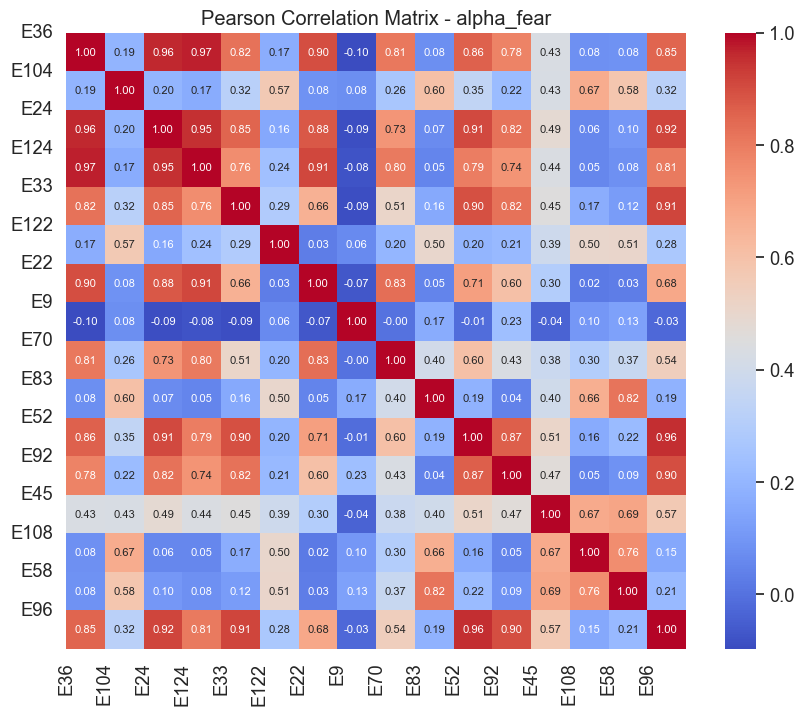

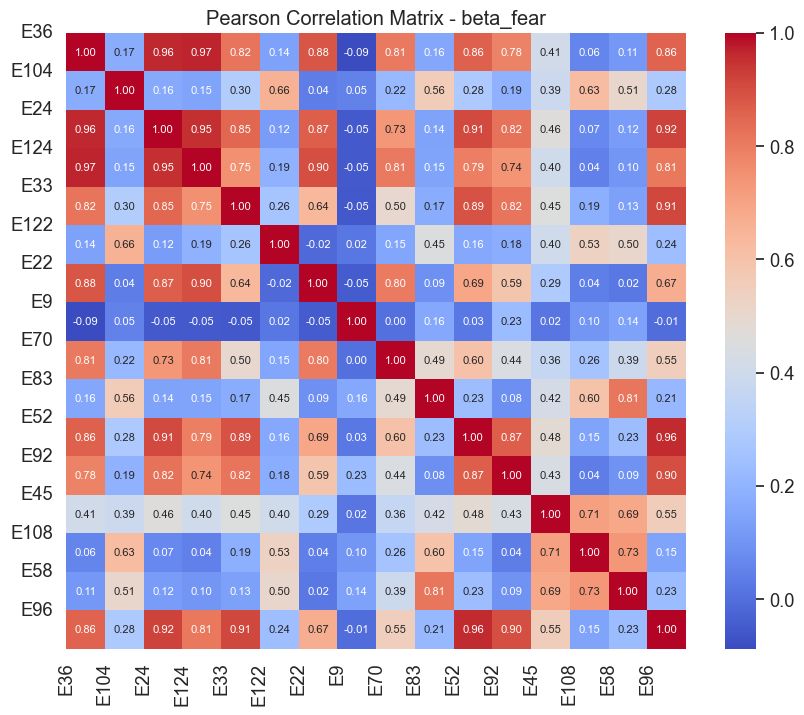

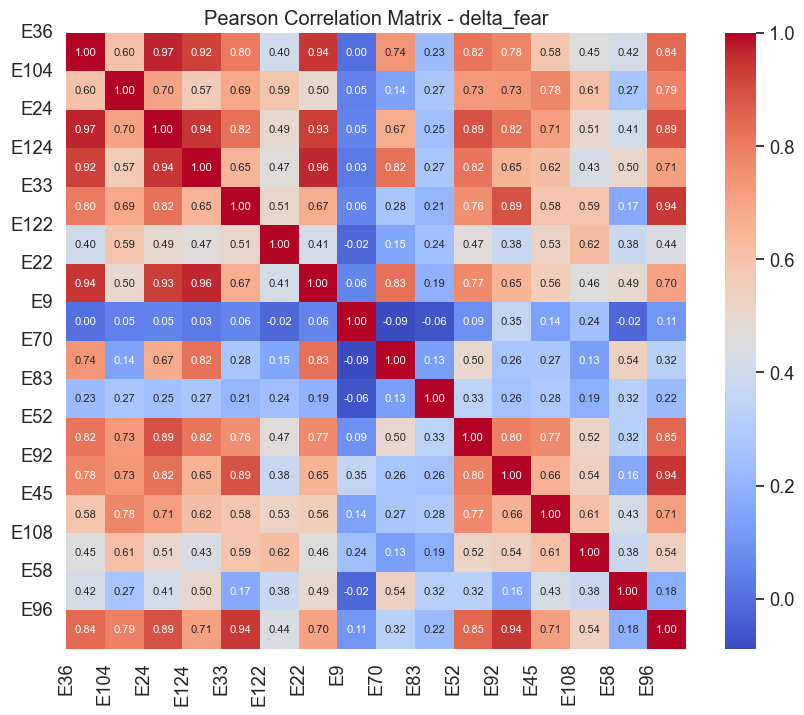

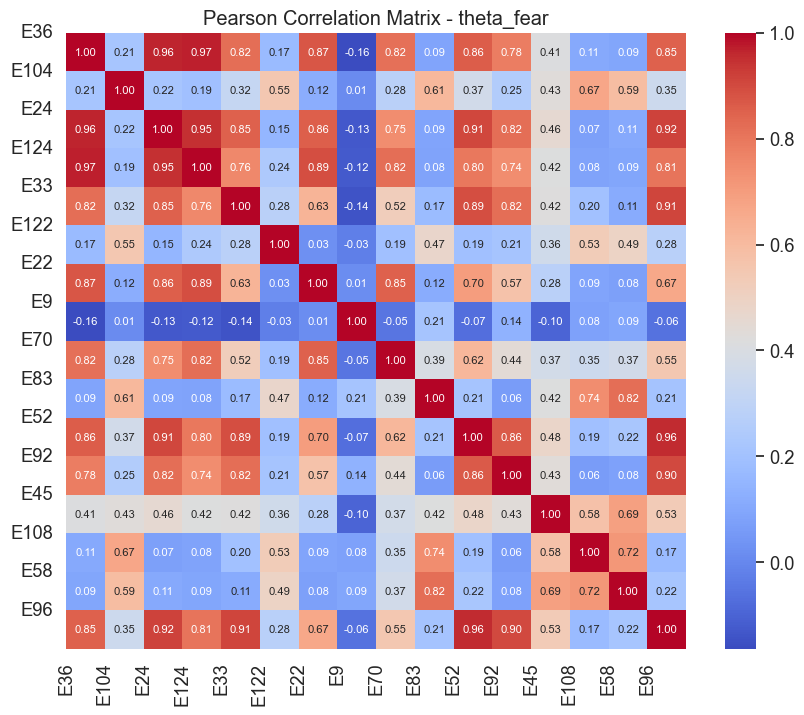

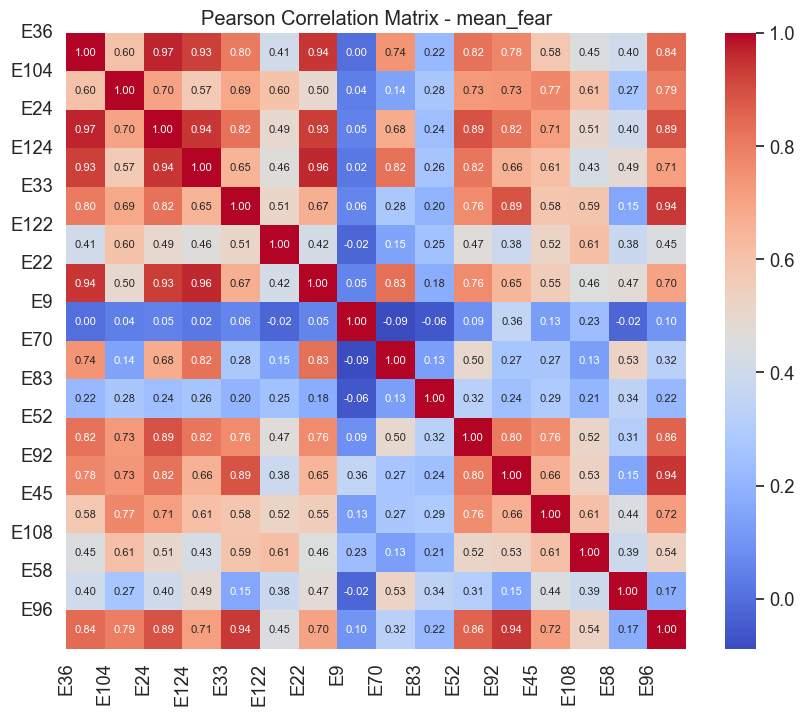

...

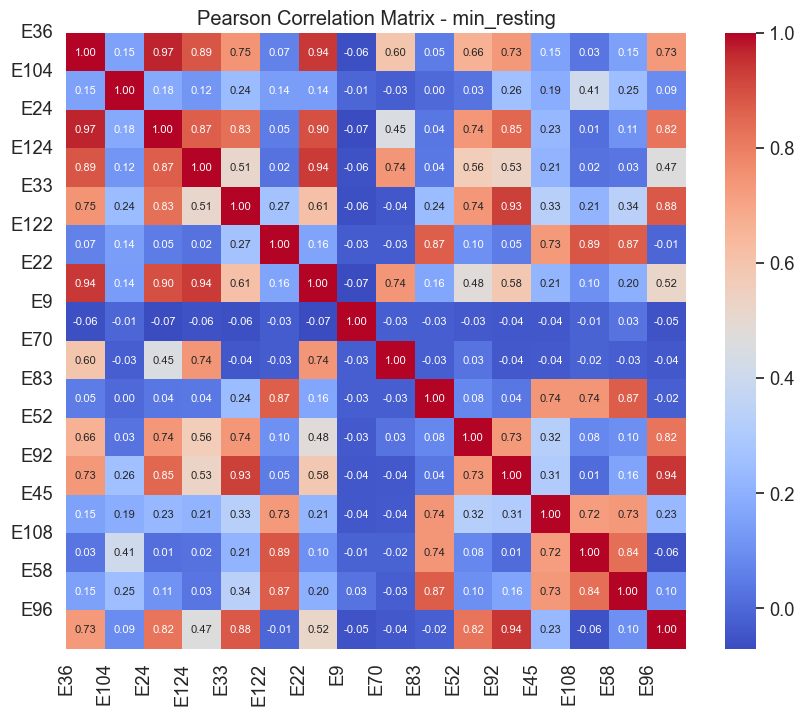

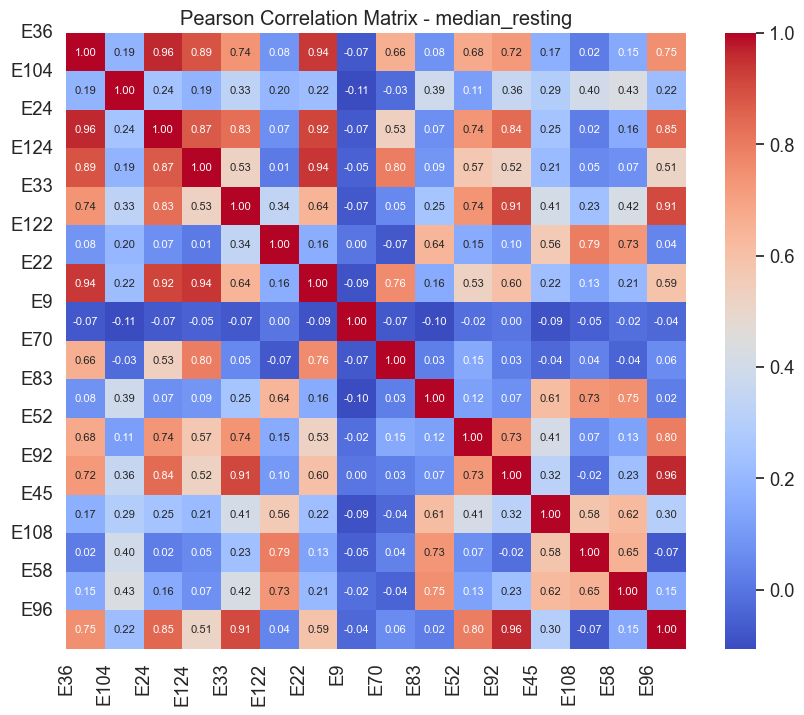

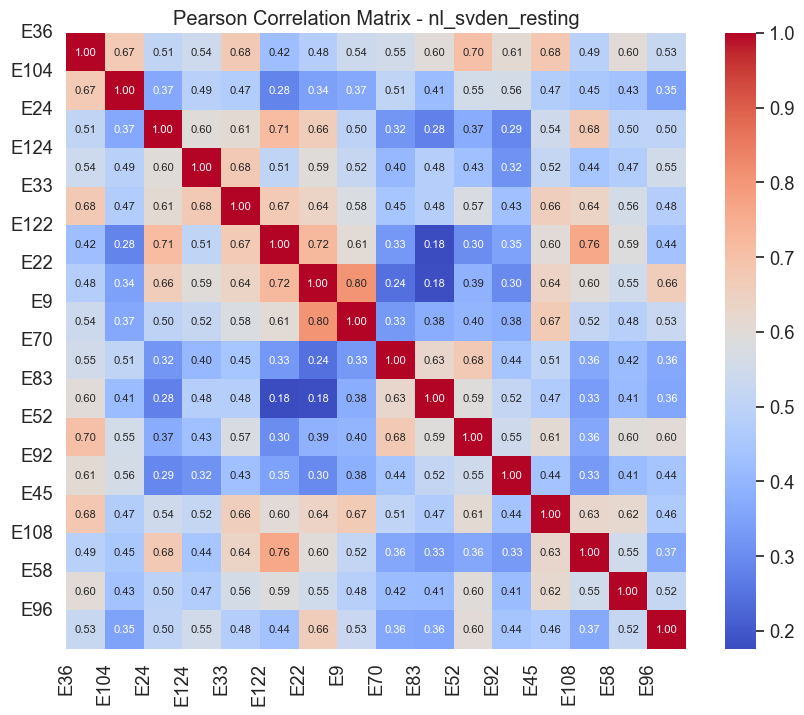

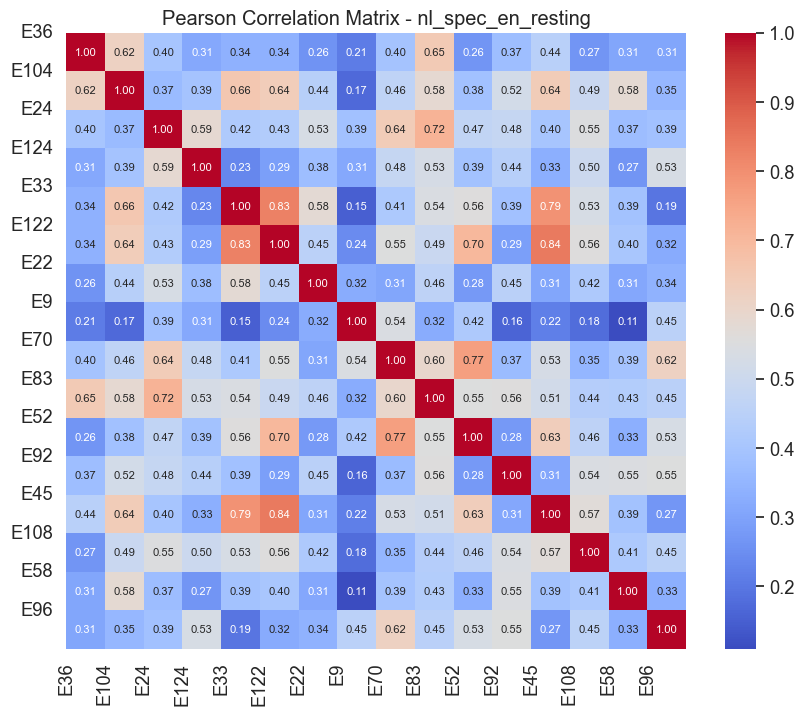

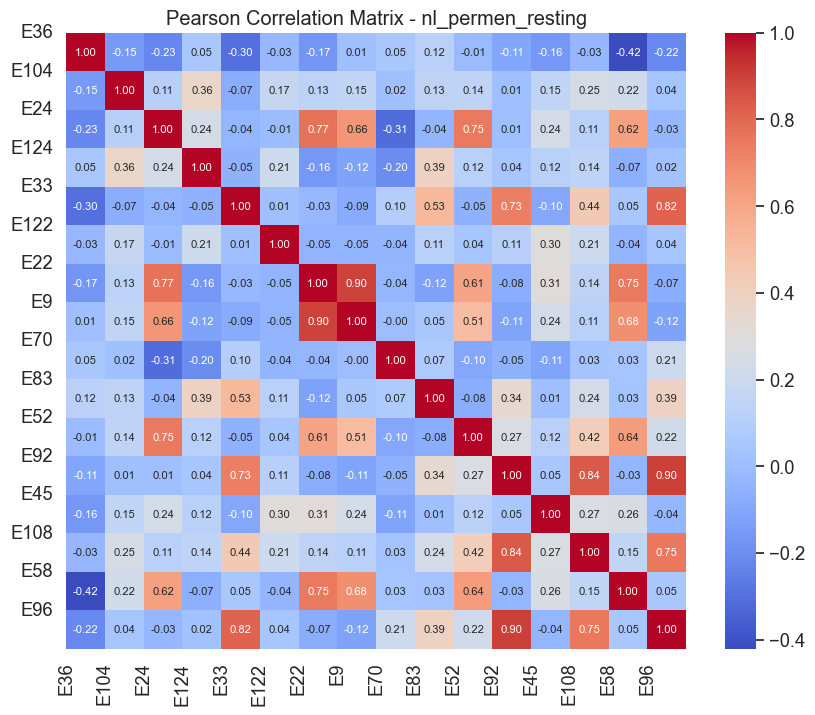

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

for key, df_small in small_dataframes.items():
    correlation_matrix = df_small.corr()

    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 8})
    plt.title(f'Pearson Correlation Matrix - {key}')  # Đặt tiêu đề với tên của DataFrame nhỏ

    column_labels = [col.split('_')[-1] for col in correlation_matrix.columns]

    # Đặt lại tên trục x và trục y bằng các nhãn chỉ có phần số cuối cùng
    plt.xticks(ticks=range(len(correlation_matrix.columns)), labels=column_labels)
    plt.yticks(ticks=range(len(correlation_matrix.columns)), labels=column_labels)

    plt.show()


## loại bỏ các kênh có độ tương quan >0.9

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


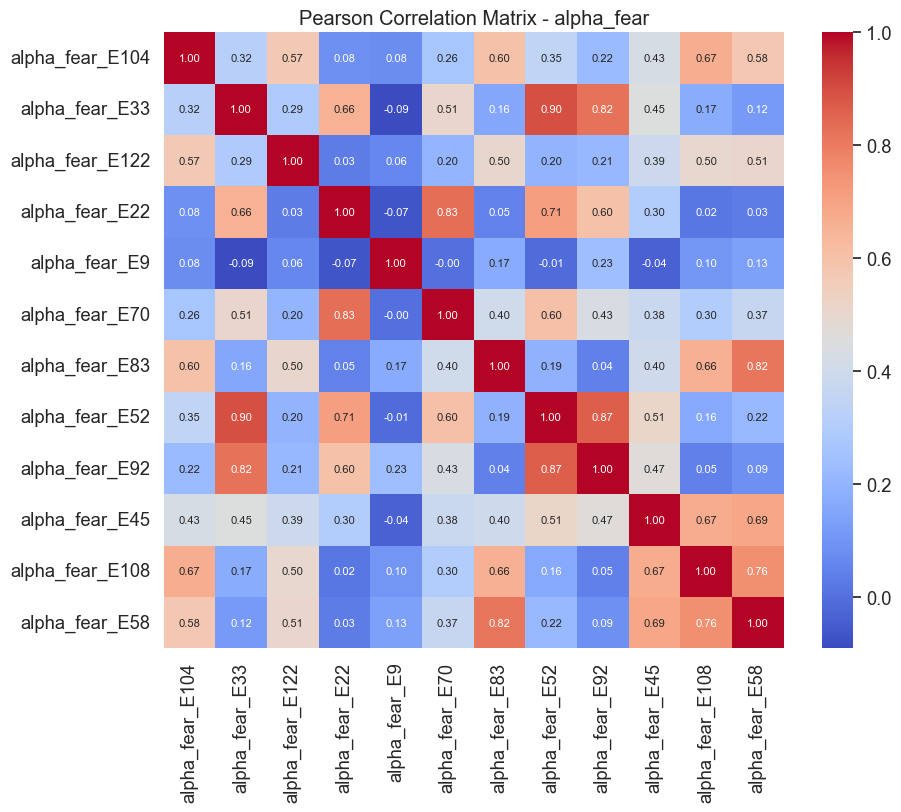

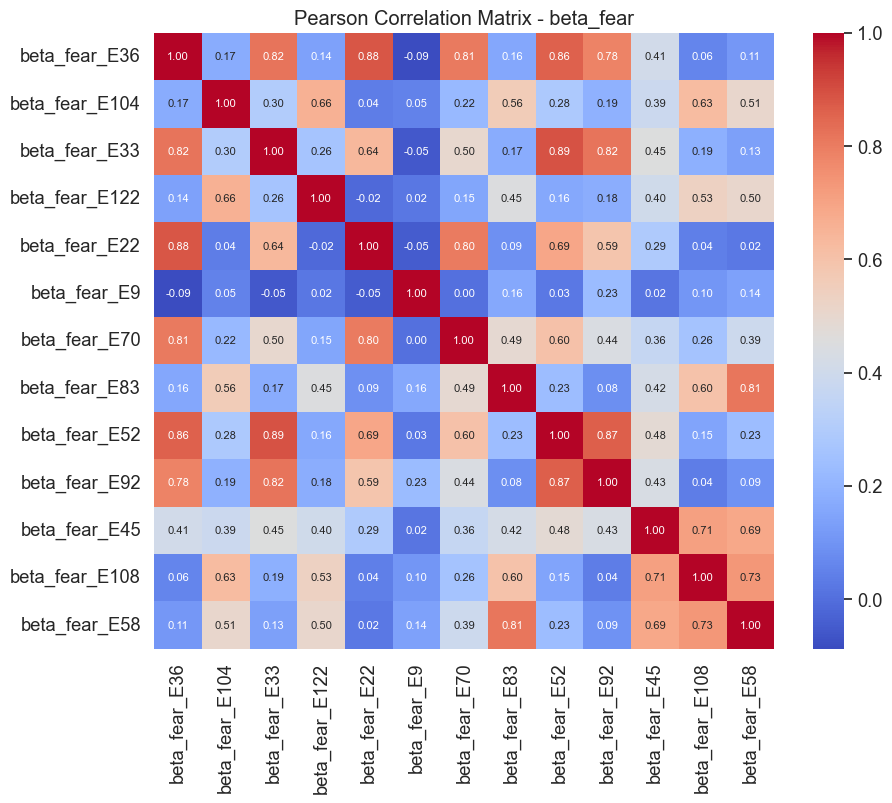

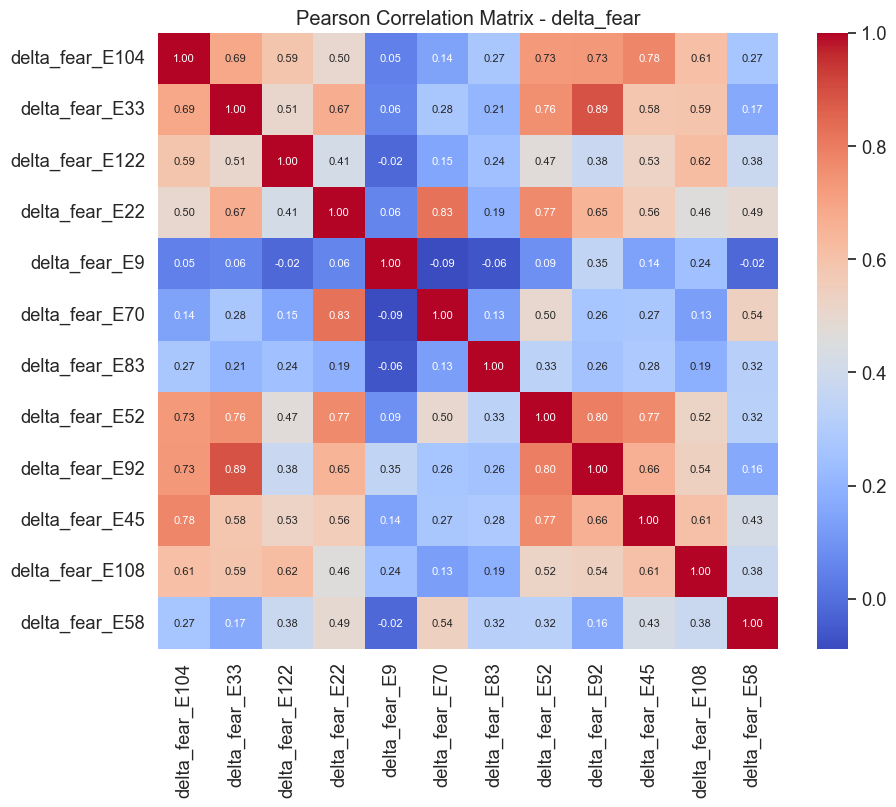

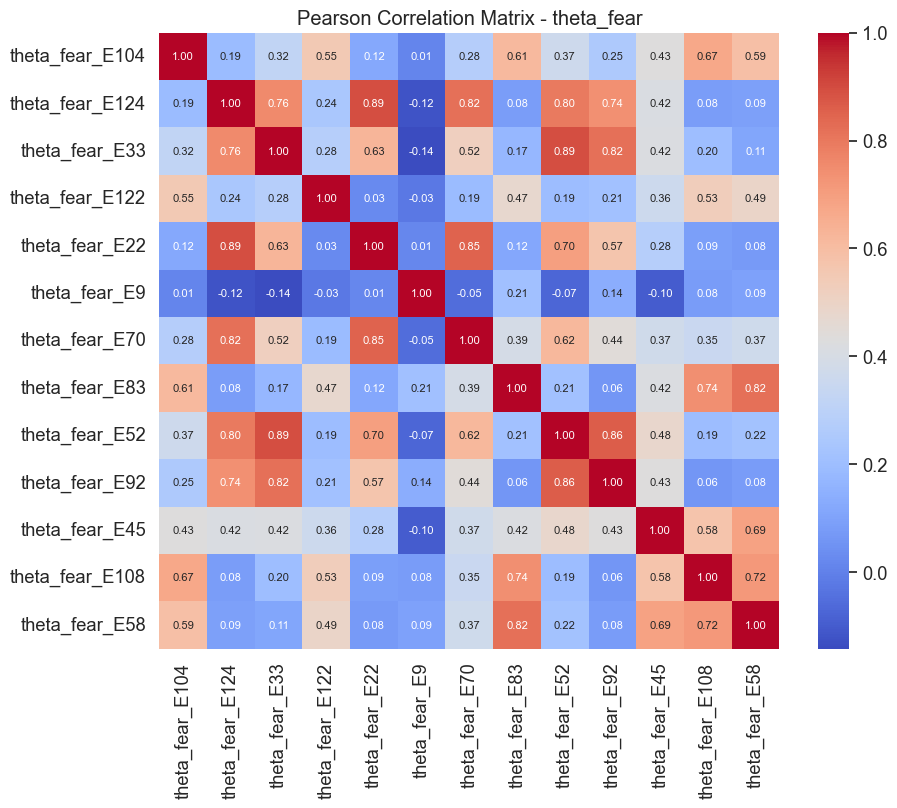

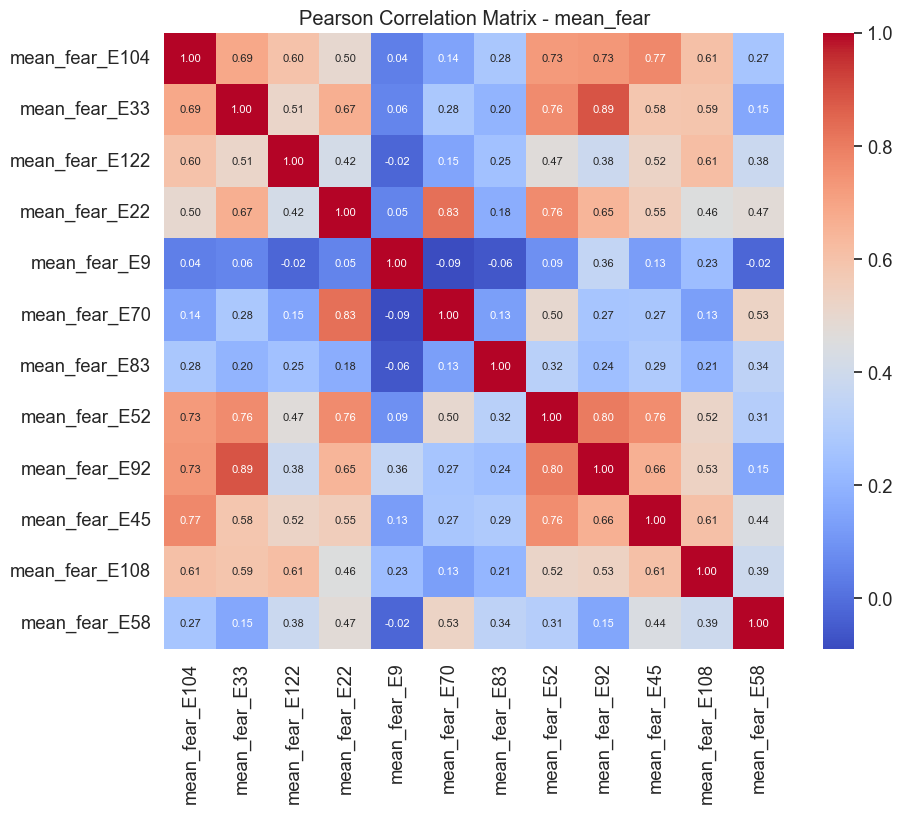

...

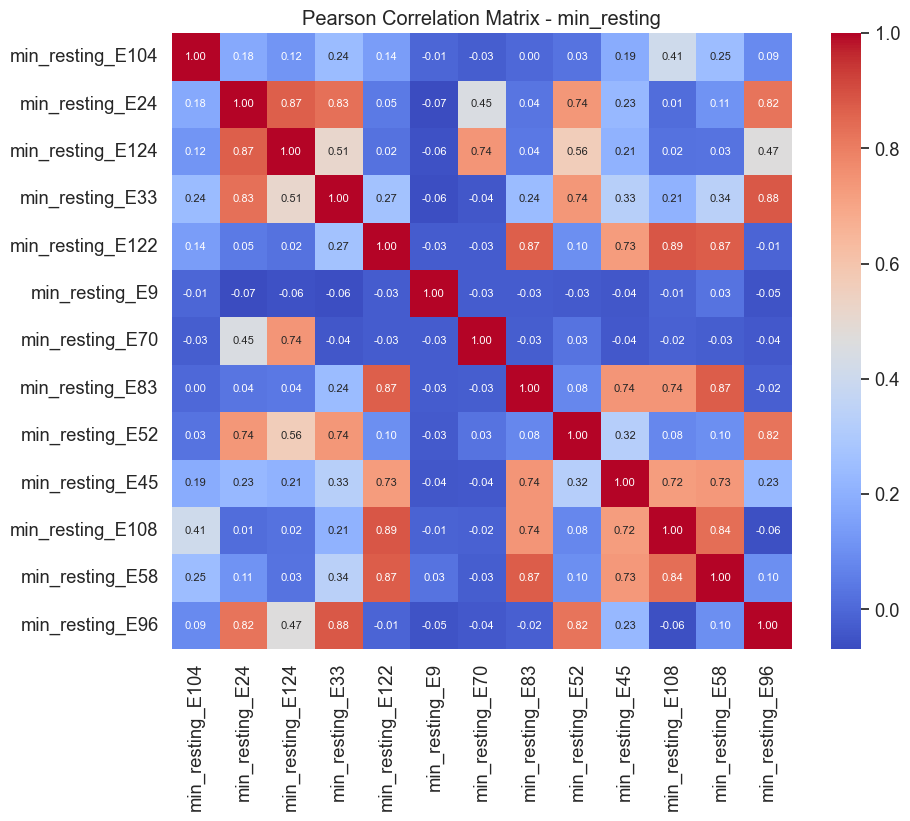

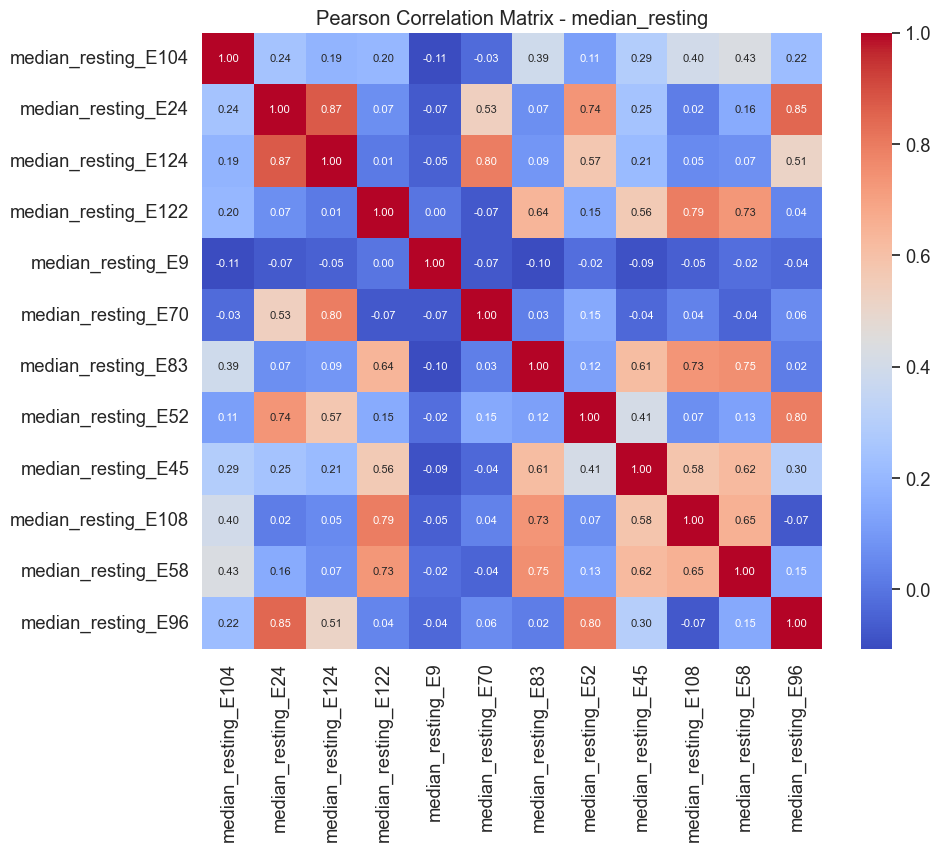

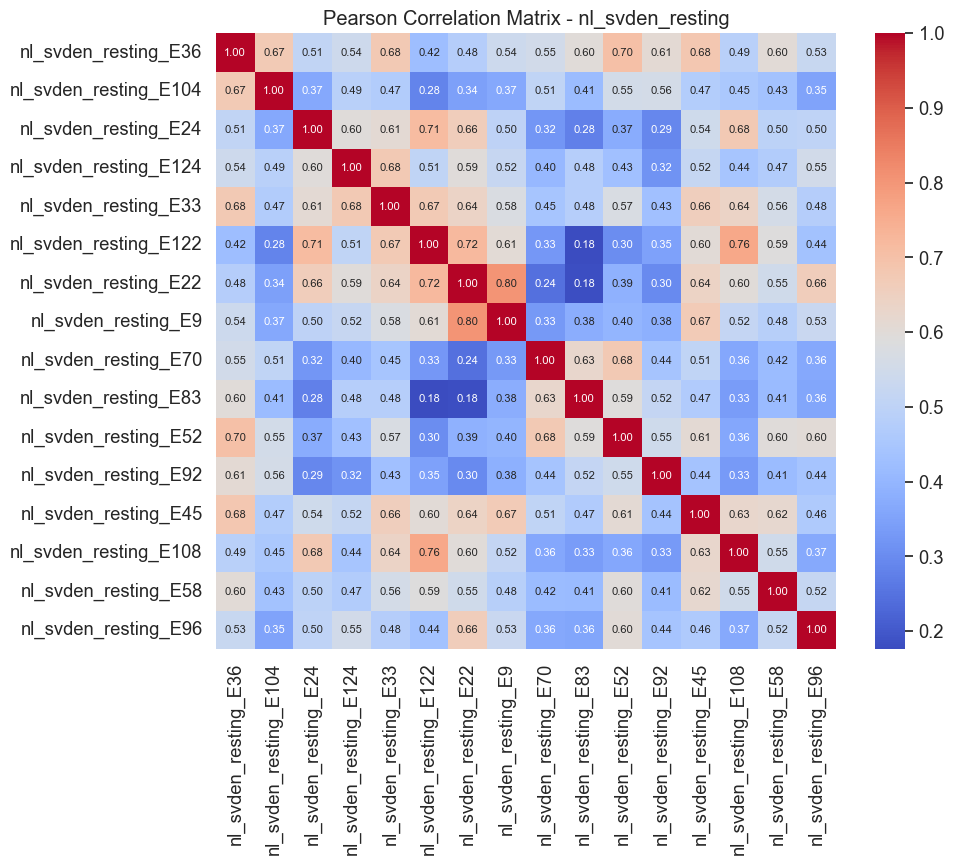

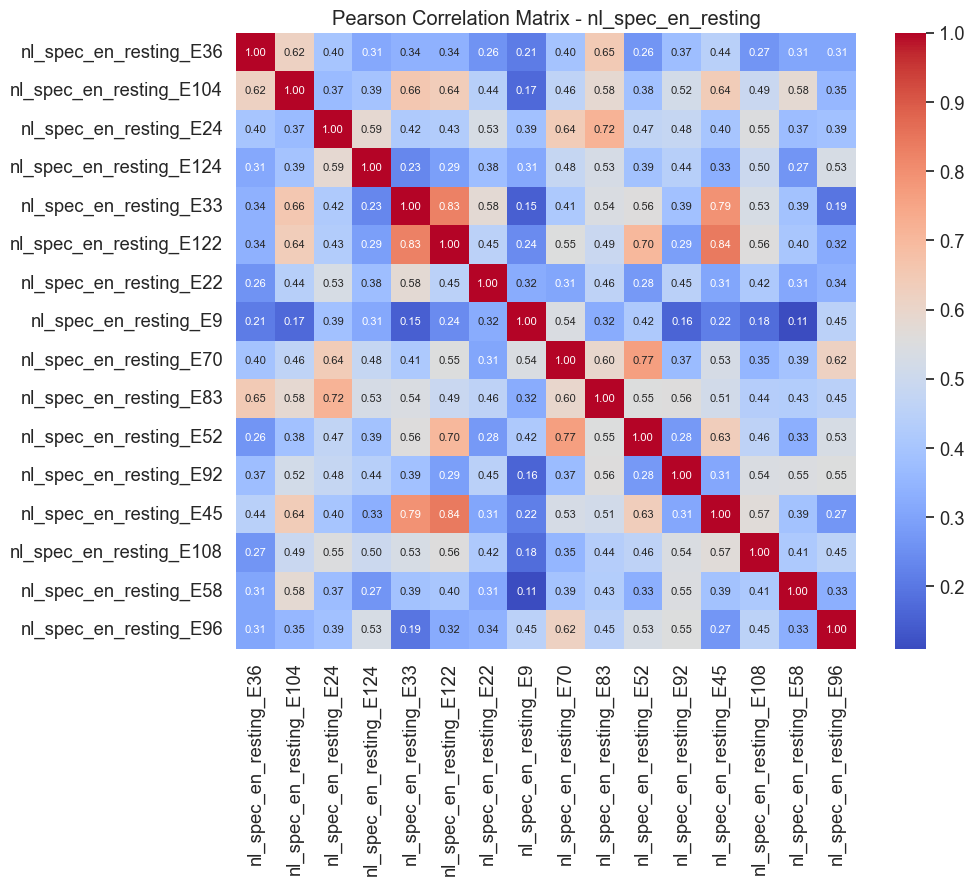

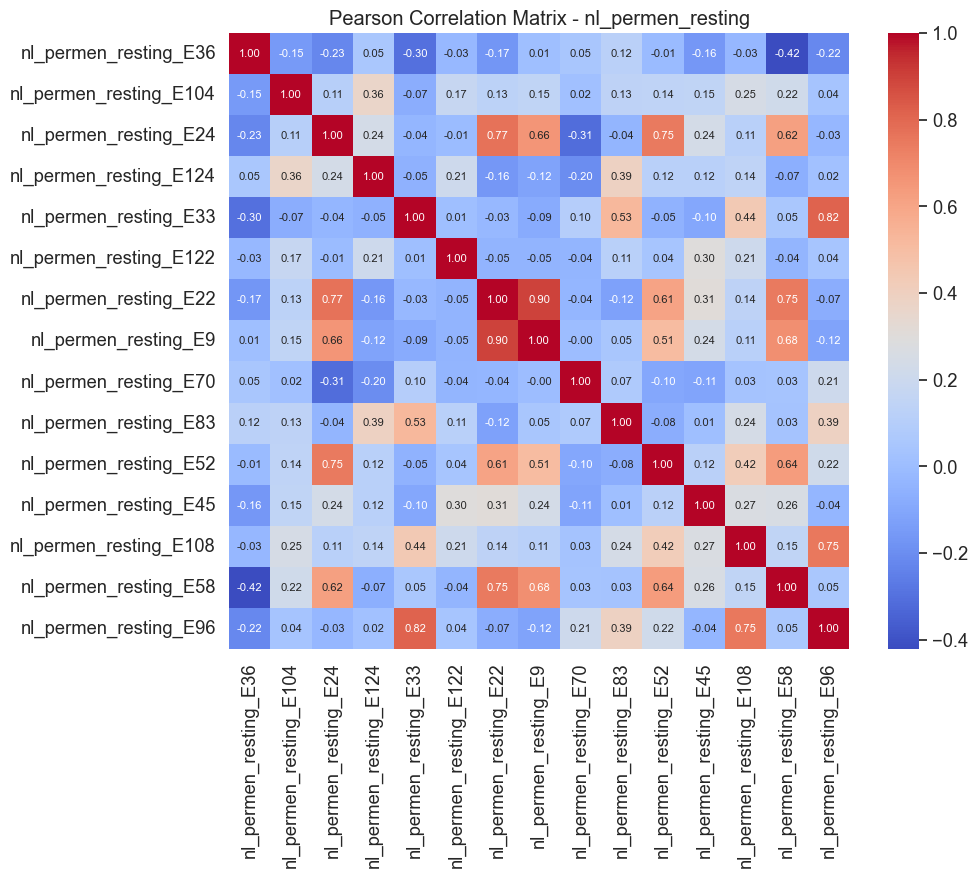

In [6]:
import numpy as np

def column_eliminator(df, thr=0.9):
    columns = np.full((df.shape[1],), True, dtype=bool)  # Sửa lại df.shape[0] thành df.shape[1] để lấy số lượng cột
    correlation_counts = np.zeros((df.shape[1],), dtype=int)  # Mảng để đếm số lượng tương quan cao cho mỗi cột

    # Đếm số lượng tương quan cao cho mỗi cột
    for i in range(df.shape[1]):
        for j in range(df.shape[1]):
            if i != j and abs(df.iloc[:,i].corr(df.iloc[:,j])) >= thr:  # Sử dụng hàm .corr() để tính tương quan và sử dụng abs() để lấy giá trị tuyệt đối
                correlation_counts[i] += 1

    # Duyệt qua các cặp cột và so sánh số lượng tương quan cao
    for i in range(df.shape[1]):
        for j in range(i + 1, df.shape[1]):
            if abs(df.iloc[:,i].corr(df.iloc[:,j])) >= thr:  # Sử dụng hàm .corr() để tính tương quan và sử dụng abs() để lấy giá trị tuyệt đối
                # So sánh số lượng tương quan cao và chỉ đánh dấu cột có nhiều mối tương quan cao hơn
                if correlation_counts[i] >= correlation_counts[j]:
                    columns[i] = False
                else:
                    columns[j] = False

    return columns

# Sử dụng hàm column_eliminator để loại bỏ các cột dựa trên ngưỡng tương quan
for key, df_small in small_dataframes.items():
    correlation_matrix = df_small.corr()
    columns_to_keep = column_eliminator(df_small)

    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix.iloc[columns_to_keep, columns_to_keep], annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 8})
    plt.title(f'Pearson Correlation Matrix - {key}')  # Đặt tiêu đề với tên của DataFrame nhỏ


In [7]:
def column_eliminator(df, thr = 0.9):
    columns = np.full((df.shape[1],), True, dtype=bool) #lấy số lượng cột
    corralation_counts = np.zeros((df.shape[1],), dtype=int) # mảng đếm số lượng tương quan của một channels

    # đếm số lượng tương quan > 0.9 của mỗi cột
    for i in range(df.shape[1]):
        for j in range(df.shape[1]):
            if j != i and abs(df.iloc[:, i].corr(df.iloc[:,j])) >= thr:
                corralation_counts[i] += 1 
    
    # so sánh số lượng tương quan cao, và xóa đi cột có nhiều tương quan hơn
    for i in range(df.shape[1]):
        for j in range(i+1, df.shape[1]):
            if abs(df.iloc[:, i].corr(df.iloc[:, j])) >= thr:
                if corralation_counts[i] >= corralation_counts[j]:
                    columns[j] = False
                else:
                    columns[i] = False
    return columns

In [8]:
removed_columns = []

for key, df_small in small_dataframes.items():
    columns_to_keep = column_eliminator(df_small) # những cột còn giữ lại
    columns = df_small.columns.tolist() #lấy tất cả các cột ban đầu

    # tìm cột bị bỏ và vất vào removed_column[]
    
    removed = [col for col, keep in zip(columns, columns_to_keep) if not keep]
    removed_columns.extend(removed)

    print(f"Các cột còn lại trong Dataframe: '{key}' :")
    remaining = [col for col, keep in zip(columns, columns_to_keep) if keep]
    print(remaining)
    print()

print("Các cột bị loại bỏ là: ")
print(removed_columns)


Các cột còn lại trong Dataframe: 'alpha_fear' :
['alpha_fear_E104', 'alpha_fear_E24', 'alpha_fear_E122', 'alpha_fear_E9', 'alpha_fear_E70', 'alpha_fear_E83', 'alpha_fear_E45', 'alpha_fear_E108', 'alpha_fear_E58']

Các cột còn lại trong Dataframe: 'beta_fear' :
['beta_fear_E104', 'beta_fear_E24', 'beta_fear_E122', 'beta_fear_E9', 'beta_fear_E70', 'beta_fear_E83', 'beta_fear_E45', 'beta_fear_E108', 'beta_fear_E58']

Các cột còn lại trong Dataframe: 'delta_fear' :
['delta_fear_E36', 'delta_fear_E104', 'delta_fear_E122', 'delta_fear_E9', 'delta_fear_E70', 'delta_fear_E83', 'delta_fear_E52', 'delta_fear_E45', 'delta_fear_E108', 'delta_fear_E58', 'delta_fear_E96']

Các cột còn lại trong Dataframe: 'theta_fear' :
['theta_fear_E104', 'theta_fear_E24', 'theta_fear_E122', 'theta_fear_E22', 'theta_fear_E9', 'theta_fear_E70', 'theta_fear_E83', 'theta_fear_E45', 'theta_fear_E108', 'theta_fear_E58']

Các cột còn lại trong Dataframe: 'mean_fear' :
['mean_fear_E36', 'mean_fear_E104', 'mean_fear_E122',

In [9]:
len(removed_columns)

191

In [10]:
removed_df = pd.DataFrame({"removed_columns": removed_columns})
removed_df.to_excel("removed_columns_1.xlsx", index = False)

In [11]:

df_1 = pd.read_excel("C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/Excel/intermediate_df.xlsx")

df_1 = df_1.drop(columns=removed_columns)

df_1.to_excel("df_1.xlsx", index=False)


In [12]:
len(df_1.columns)

514

In [10]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import pandas as pd
df_1 = pd.read_excel("C:\\Users\\ThuyLe\\Desktop\\Diagnosing-depression-using-EEG-main\\EEG_main\\Code\\df_1.xlsx")
X = df_1.drop(['type'], axis=1)  # Loại bỏ cột nhãn khỏi đặc trưng
y = df_1['type']  # label

X_encoded = pd.get_dummies(X, drop_first=True)  # Chuyển đổi cột dạng chuỗi
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

#model = SVC(random_state=30)
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)
predict = model.predict(X_test)
acc = accuracy_score(y_test, predict)
print(acc)


0.5454545454545454


In [7]:
from sklearn.metrics import accuracy_score
import numpy as np
# Khởi tạo mô hình
models = {
    'Random Forest': RandomForestClassifier(random_state=42),
    'Logistic Regression': LogisticRegression(random_state=42),
    'KNN': KNeighborsClassifier(7),
    'SVC': SVC(random_state=42)
}


X_train_np = X_train.values  # Chuyển DataFrame sang mảng NumPy
X_test_np = X_test.values

for name, model in models.items():
    model.fit(X_train_np, y_train)  # Huấn luyện mô hình
    predictions = model.predict(X_test_np)  # Dự đoán trên tập kiểm tra
    accuracy = accuracy_score(y_test, predictions)  # Tính độ chính xác
    print(f"{name} Accuracy: {accuracy:.2f}")



Random Forest Accuracy: 0.55
Logistic Regression Accuracy: 0.73
KNN Accuracy: 0.82
SVC Accuracy: 0.64
(42,)


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


In [14]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Chuẩn hóa dữ liệu
scaler = StandardScaler()
X_scaled = pd.DataFrame(scaler.fit_transform(X))
X_scaled

,0,1,2,3,4,5,6,7,8,9,...,503,504,505,506,507,508,509,510,511,512
0,-0.043812,-0.051899,-0.023785,-0.046962,-0.061649,0.010824,-0.365821,-0.382844,-0.409693,-0.327439,...,-0.774956,-0.691406,-0.404018,-0.339209,-0.873295,-0.616363,0.796247,-3.765800,-0.408730,-0.321814
1,-0.477020,-0.476237,-0.467529,-0.442672,-0.443945,-0.436221,-0.437376,-0.428805,-0.426152,-0.328367,...,-0.966150,-0.022930,0.454277,-0.342532,-1.056176,-0.228266,-0.910873,0.165539,-0.737894,-0.637140
2,-0.423389,-0.423782,-0.405636,-0.403297,-0.404388,-0.379782,-0.417623,-0.426425,-0.404495,-0.328833,...,-0.570854,-0.813127,-0.698422,-0.345612,-0.451279,0.826101,-0.809504,-0.186985,3.111766,-0.648691
3,-0.320814,-0.322540,-0.309770,-0.284624,-0.288310,-0.271971,-0.364644,-0.355730,-0.351000,-0.328853,...,-0.423900,-0.076019,0.166898,-0.322076,-0.267825,-0.663145,0.335290,-0.011584,-0.791434,0.151341
4,-0.186018,-0.187645,-0.157140,-0.193803,-0.201107,-0.174959,-0.411324,-0.422815,-0.396054,-0.327364,...,1.746802,0.939600,0.373593,0.758735,1.693770,-0.527520,0.185216,0.091154,-0.698732,0.365125
5,-0.428098,-0.428203,-0.390798,-0.411126,-0.411249,-0.385228,-0.303665,-0.381134,-0.367341,-0.327080,...,-0.134510,-0.960296,-1.071217,-0.305386,-0.038510,0.017090,0.263505,0.153353,-0.795166,3.869429
6,0.011940,-0.001193,0.092000,0.020584,0.004722,0.129654,-0.377651,-0.285702,-0.416137,-0.327598,...,-0.632315,-0.081805,0.164411,-0.295463,-0.160795,-0.341272,-0.428334,-0.019036,-0.401287,-0.575159
7,-0.330356,-0.314024,-0.396615,-0.355561,-0.352968,-0.364483,-0.329643,-0.264062,-0.355421,-0.326262,...,2.309971,0.622762,-0.562916,0.048024,2.363291,0.108142,-0.414619,0.013069,-0.265217,-0.452196
8,-0.395037,-0.398199,-0.352960,-0.380363,-0.378471,-0.384018,-0.375015,-0.370535,-0.388569,-0.325470,...,-0.465739,-0.409158,-0.247575,-0.340135,-0.604380,0.532860,-0.895544,0.071838,0.503449,-0.738005
9,-0.475636,-0.474869,-0.481996,-0.455839,-0.454730,-0.469367,-0.352403,-0.341574,-0.346358,-0.328921,...,-0.472070,-0.146175,-0.097572,-0.304731,-0.505228,-0.411697,0.050614,0.104438,-0.704261,0.741470


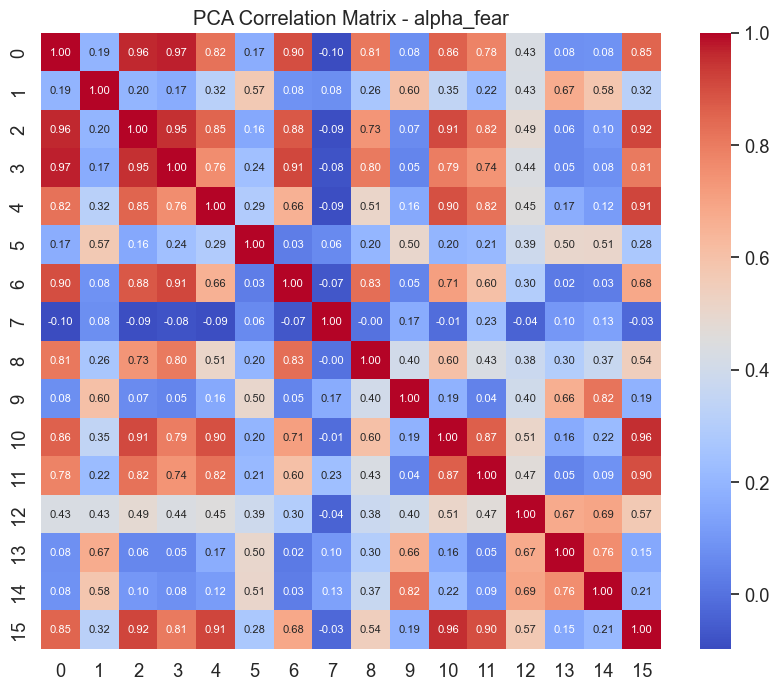

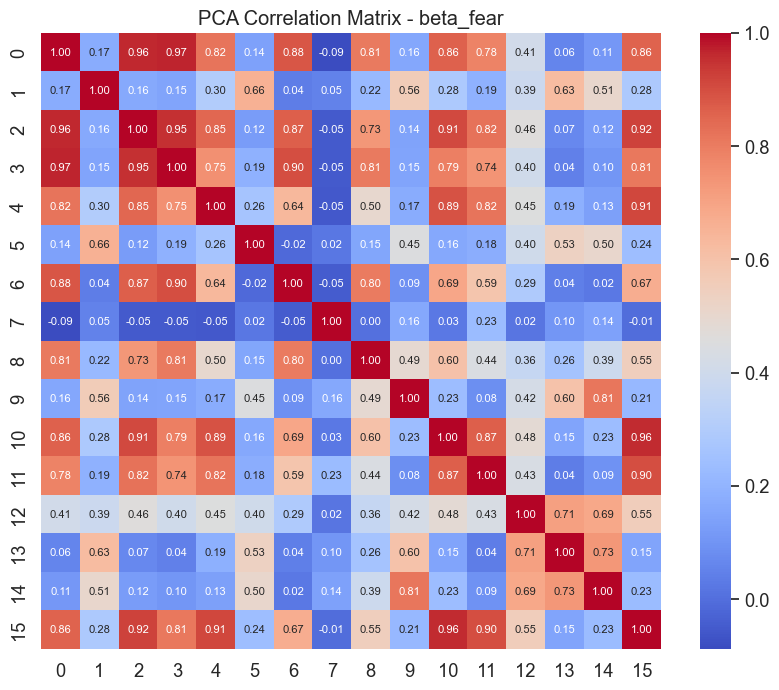

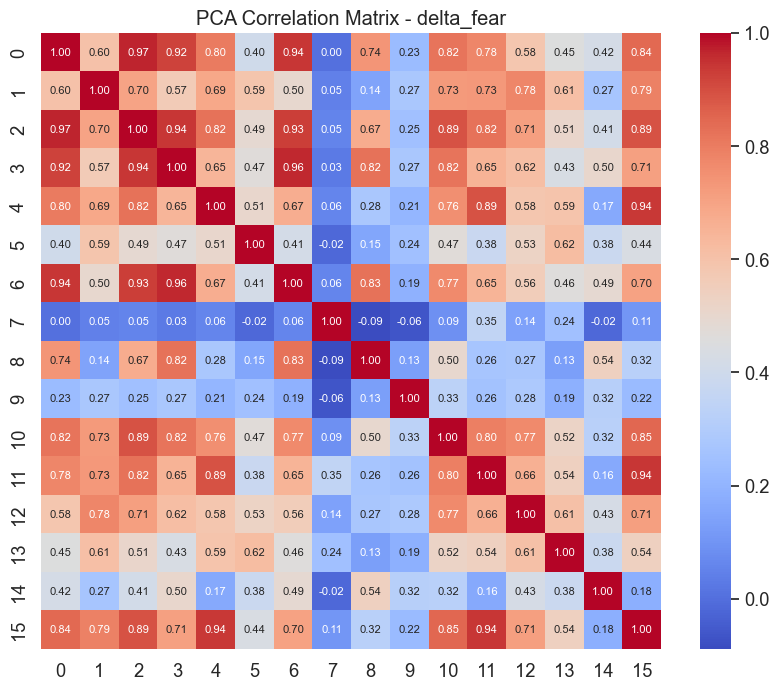

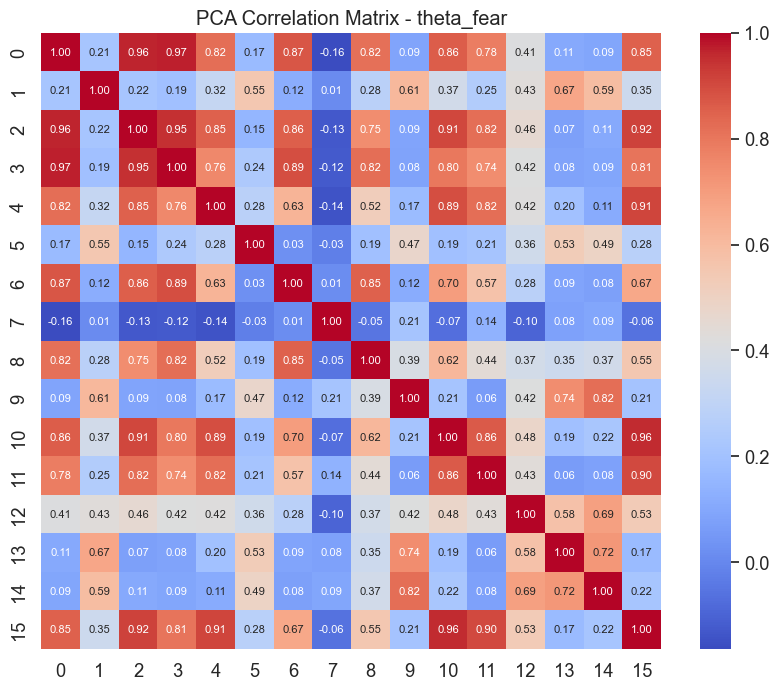

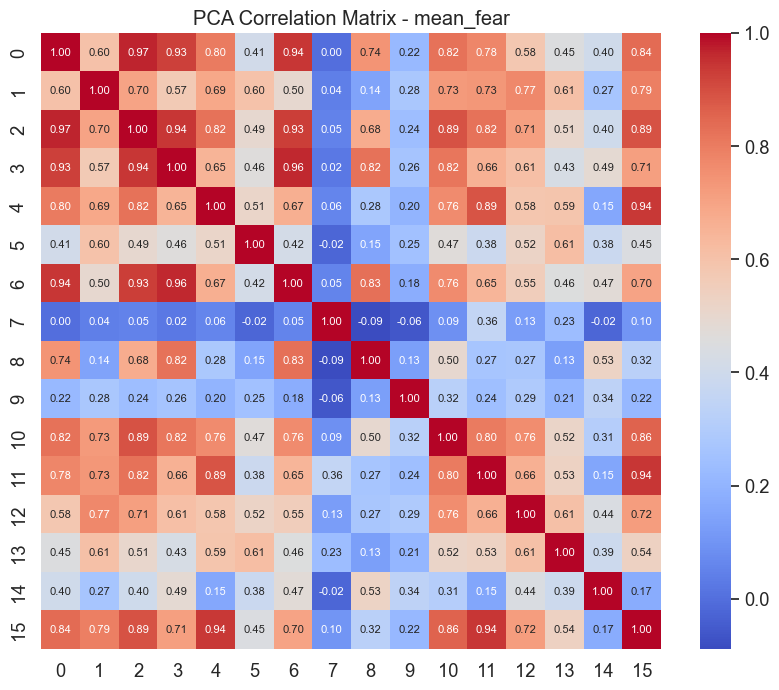

...

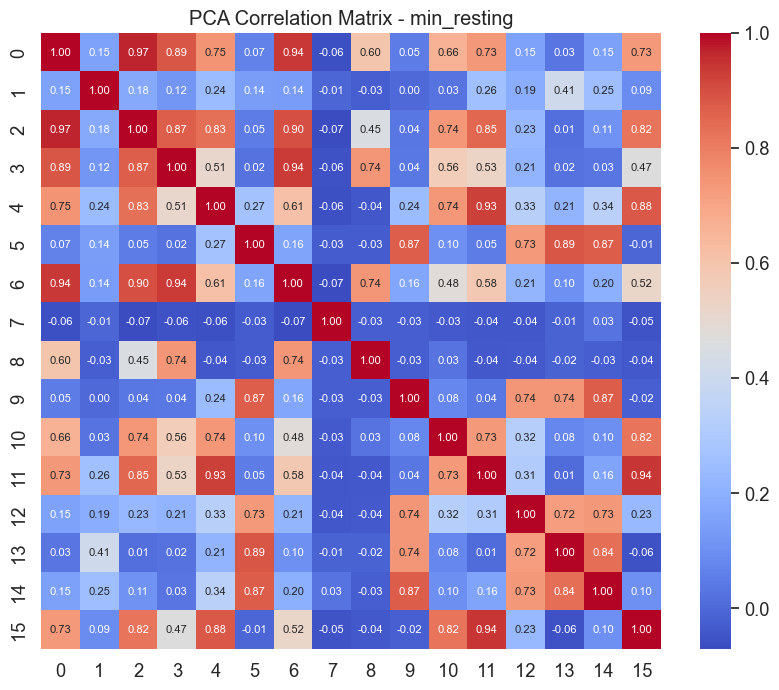

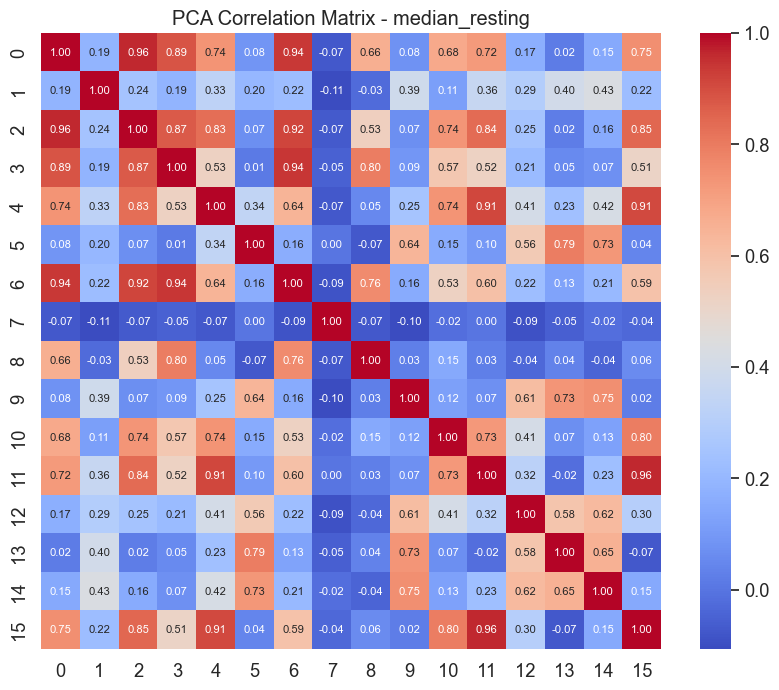

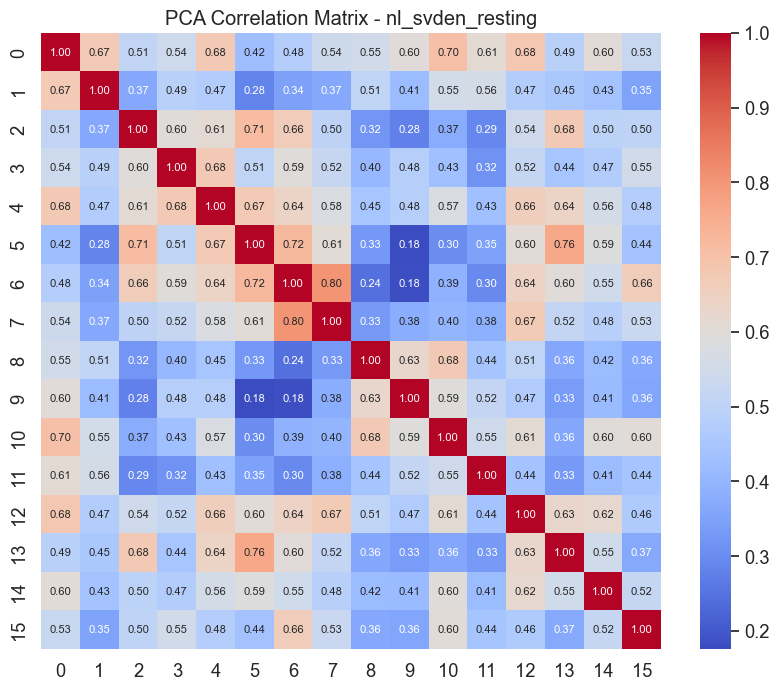

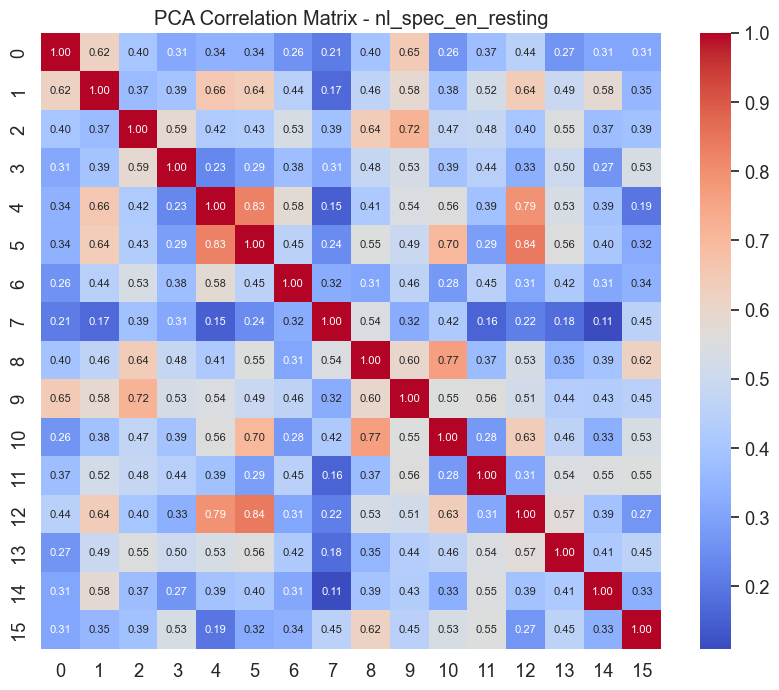

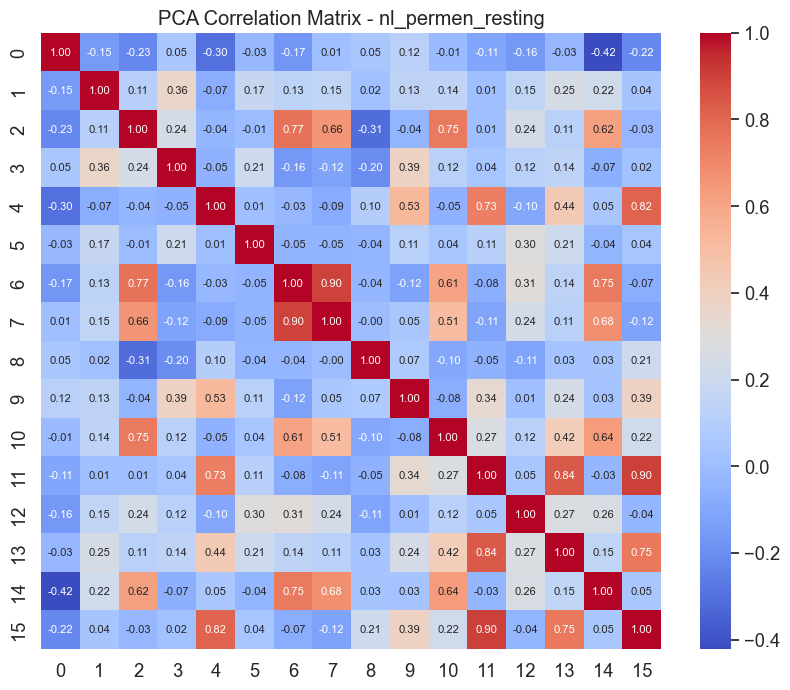

In [22]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

scaler = StandardScaler()
for key, df_small in small_dataframes.items():
    scaled_data = scaler.fit_transform(df_small)
    
    # Tính ma trận tương quan cho dữ liệu đã giảm chiều
    correlation_matrix = pd.DataFrame(scaled_data).corr()
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 8})
    plt.title(f'PCA Correlation Matrix - {key}')  # Đặt tiêu đề với tên của DataFrame nhỏ
    plt.show()


In [24]:
X_scale = scaler.fit(X_train).transform(X_train)
X_scale_test = scaler.transform(X_test)

n_com = 20
pca = PCA(n_components = n_com, random_state=42).fit(X_scale)
n_com_lst = []
for i in range(1, n_com+1):
    str = f"PC{i}"
    n_com_lst.append(f"PC{i}")

df_2 = pd.DataFrame(
    {'explained var ratio':pca.explained_variance_ratio_,
    'pc':n_com_lst}
)


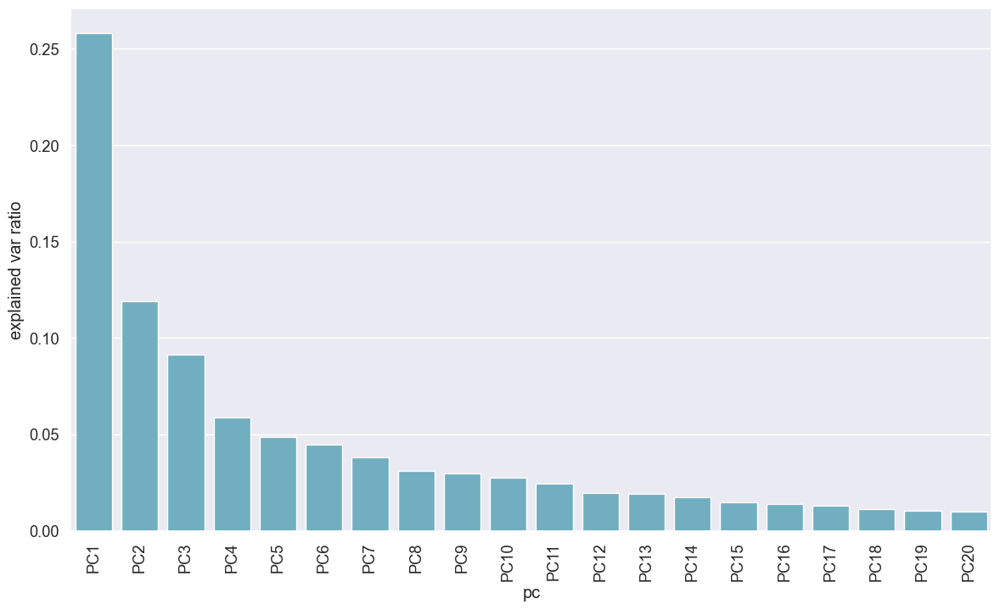

0     0.258196
1     0.377159
2     0.468512
3     0.527099
4     0.575620
5     0.620285
6     0.658493
7     0.689462
8     0.718972
9     0.746426
10    0.770648
11    0.790121
12    0.809093
13    0.826428
14    0.841386
15    0.855043
16    0.867949
17    0.879353
18    0.889651
19    0.899500
Name: explained var ratio, dtype: float64


In [26]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
plt.figure(figsize=(14, 8)) 
sns.barplot(x='pc', y="explained var ratio", data=df_2, color="c")
plt.xticks(rotation=90)  # Xoay nhãn 90 độ
plt.show()

# Tính tổng tích lũy của explained variance ratio
cumulative_explained_variance = np.cumsum(df_2['explained var ratio'])
print(cumulative_explained_variance)

In [30]:
scalar = StandardScaler() 
X_pca = df_1.drop(['type'], axis=1)  # Loại bỏ cột nhãn khỏi đặc trưng
scaled_data = pd.DataFrame(scalar.fit_transform(X_pca)) #scaling the data
pca = PCA(n_components = 20)
pca.fit(scaled_data)
data_pca = pca.transform(scaled_data)

y = df_1['type']  # Nhãn

X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(data_pca, y, test_size=0.2, random_state=42)

# Huấn luyện mô hình SVM
svm_model = SVC(random_state=42)
svm_model.fit(X_train_pca, y_train_pca)

predict_pca = svm_model.predict(X_test_pca)
acc_pca = accuracy_score(y_test_pca, predict)
print(acc_pca)

0.6363636363636364
